# Lets Grow More

# LGMVIP MAY 2022

# Intership Domain : Data Science


# Intern Name : Shrimali Vrushabhkumar

# Task Level : INTERMEDIATE LEVEL TASK

# Task 2 : Exploratory Data Analysis on Dataset - Terrorism 

Import Libraries

In [7]:
import pandas as pd
import numpy as np
import chardet
import matplotlib.pyplot as plt
import seaborn as sns

In [8]:
#import dataset
path = "globalterrorismdb_0718dist.csv"
with open(path, 'rb') as rawdata:
    result = chardet.detect(rawdata.read(100000))
result

{'encoding': 'ISO-8859-1', 'confidence': 0.73, 'language': ''}

In [9]:
df = pd.read_csv(path,encoding='ISO-8859-1')
df.head()

c:\users\shrim\appdata\local\programs\python\python39\lib\site-packages\IPython\core\interactiveshell.py:3441: DtypeWarning: Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [10]:
df.rename(columns = {'iyear':'Year','imonth':'Month', 'iday':'Day', 'country_txt':'Country','region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type','motive':'Motive'},inplace=True)
df=df[['Year','Month','Day','Country','Region','city','latitude','longitude','AttackType','Killed','Wounded','Target','Summary','Group','Target_type','Weapon_type','Motive']]
df['casualities']=df['Killed']+df['Wounded']
df.head(3)

,Year,Month,Day,Country,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive,casualities
0,1970,7,2,Dominican Republic,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,1.0
1,1970,0,0,Mexico,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter",NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,0.0
2,1970,1,0,Philippines,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Employee,NaN,Unknown,Journalists & Media,Unknown,NaN,1.0


In [11]:
df.isnull().sum()

Year                0
Month               0
Day                 0
Country             0
Region              0
city              434
latitude         4556
longitude        4557
AttackType          0
Killed          10313
Wounded         16311
Target            636
Summary         66129
Group               0
Target_type         0
Weapon_type         0
Motive         131130
casualities     16874
dtype: int64

In [12]:
print('Country with highest terrorist attack:',df['Country'].value_counts().index[0])
print('Regions with highest terrorist attack:',df['Region'].value_counts().index[0])
print('Maximum people killed in are:',df['Killed'].max(),'that took place in:',df.loc[df['Killed'].idxmax()].Country)

Country with highest terrorist attack: Iraq
Regions with highest terrorist attack: Middle East & North Africa
Maximum people killed in are: 1570.0 that took place in: Iraq


No. of Terrorist activities year wise from 1970-2017.

c:\users\shrim\appdata\local\programs\python\python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


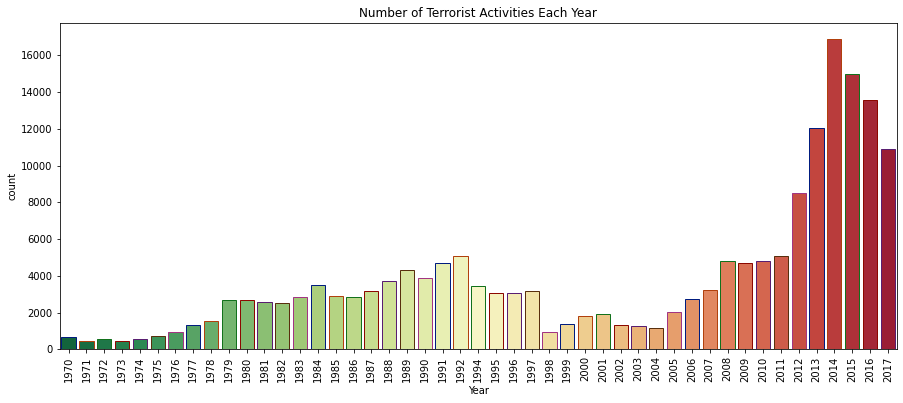

In [13]:
plt.subplots(figsize=(15,6))
sns.countplot('Year',data = df, palette = 'RdYlGn_r', edgecolor = sns.color_palette('dark',7))
plt.xticks(rotation = 90)
plt.title('Number of Terrorist Activities Each Year')
plt.show()

Different methods used for attacks

c:\users\shrim\appdata\local\programs\python\python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


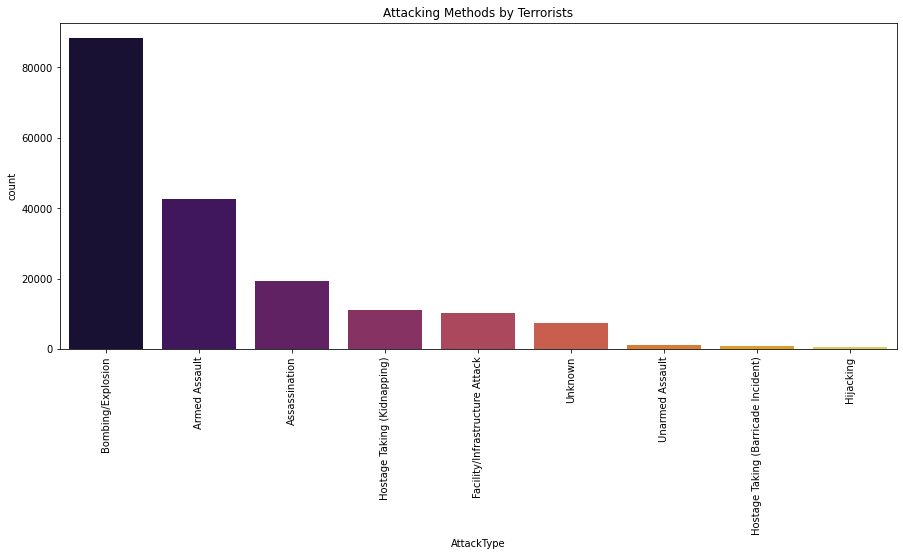

In [14]:
plt.subplots(figsize= (15,6))
sns.countplot('AttackType', data=df, palette ='inferno', order = df['AttackType'].value_counts().index)
plt.xticks(rotation = 90)
plt.title('Attacking Methods by Terrorists')
plt.show()

Favorite target

c:\users\shrim\appdata\local\programs\python\python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


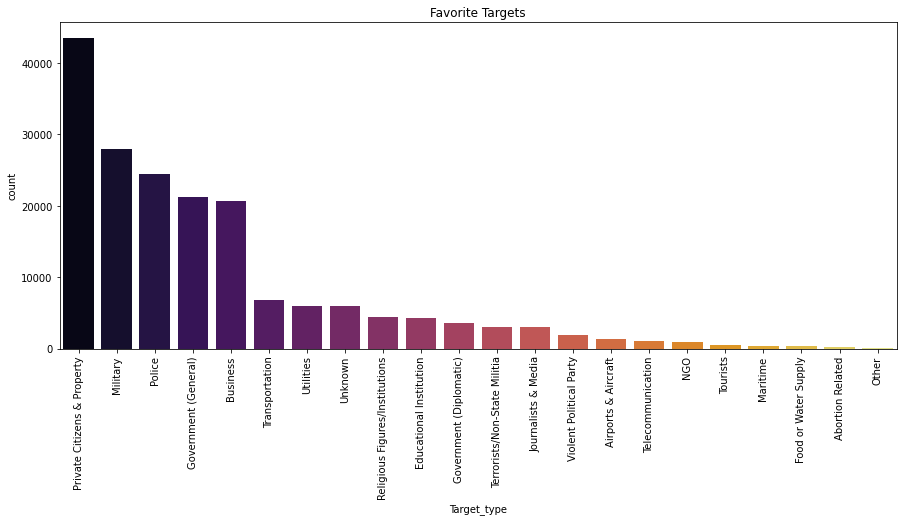

In [15]:
plt.subplots(figsize = (15,6))
sns.countplot('Target_type', data=df, palette ='inferno', order = df['Target_type'].value_counts().index)
plt.xticks(rotation = 90)
plt.title('Favorite Targets')
plt.show()

# Global Terrorist Attacks

C:\Users\shrim\AppData\Local\Temp/ipykernel_2800/3264886429.py:7: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go" (-> color='g'). The keyword argument will take precedence.
  m3.plot(x_100, y_100, 'go', markersize = 5, color = 'r')
C:\Users\shrim\AppData\Local\Temp/ipykernel_2800/3264886429.py:11: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go" (-> color='g'). The keyword argument will take precedence.
  m3.plot(x_,y_, 'go', markersize = 2, color = 'b', alpha = 0.4)


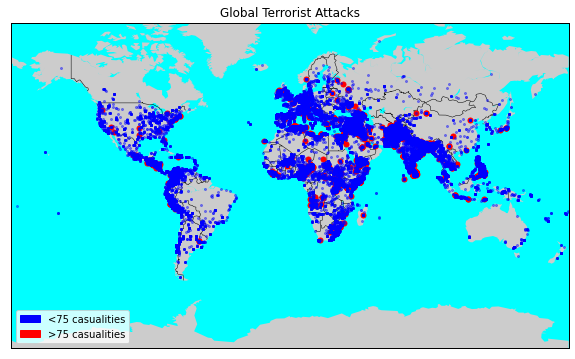

In [16]:
from mpl_toolkits.basemap import Basemap
import matplotlib.patches as mpatches
m3= Basemap (projection='mill',llcrnrlat = -80, urcrnrlat=80, llcrnrlon=-180, urcrnrlon=180, lat_ts = 20, resolution = 'c', lat_0 = True, lat_1 = True)
lat_100 = list(df[df['casualities']>=75].latitude)
long_100 = list(df[df['casualities']>=75].longitude)
x_100, y_100 = m3(long_100, lat_100)
m3.plot(x_100, y_100, 'go', markersize = 5, color = 'r')
lat_ = list(df[df['casualities']<75].latitude)
long_ = list(df[df['casualities']<75].longitude)
x_, y_ = m3(long_,lat_)
m3.plot(x_,y_, 'go', markersize = 2, color = 'b', alpha = 0.4)
m3.drawcountries()
m3.fillcontinents(lake_color = 'aqua')
m3.drawmapboundary(fill_color = 'aqua')
fig = plt.gcf()
fig.set_size_inches(10,6)
plt.title('Global Terrorist Attacks')
plt.legend(loc = 'lower left', handles = [mpatches.Patch(color='b',label="<75 casualities"), mpatches.Patch(color='red',label = '>75 casualities')])
plt.show()

In [17]:
import folium
df_fol = df.copy()
df_fol.dropna(subset=['latitude','longitude'],inplace = True)
location_fol = df_fol[['latitude','longitude']][:5000]
country_fol = df_fol['Country'][:5000]
city_fol = df_fol['city'][:5000]
killed_fol = df_fol['Killed'][:5000]
wound_fol = df_fol['Wounded'][:5000]
def color_point(x):
    if x>30:
        color = 'red'
    elif((x>0 and x<30)):
            color = 'blue'
    else:
            color = 'green'
    return color
def point_size(x):
        if(x>30 and x<100):
            size = 2
        elif(x>=100 and x<500):
            size = 8
        elif x>=500:
            size = 16
        else:
            size=0.5
        return size
map2 = folium.Map(location = [30,0],tiles = 'CartoDB dark_matter', zoom_start = 2)
for point in location_fol.index:
    info = '<b>Country:</b>'+str(country_fol[point])+'<br><b>City: </b>:'+str(city_fol[point])+'<br><b>Killed</b>:'+str(wound_fol[point])
    iframe = folium.IFrame(html=info,width= 200, height = 200)
    folium.CircleMarker(list(location_fol.loc[point].values),popup = folium.Popup(iframe),radius = point_size(killed_fol[point]),color = color_point(killed_fol[point])).add_to(map2)
map2

# Terrorism by region

c:\users\shrim\appdata\local\programs\python\python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


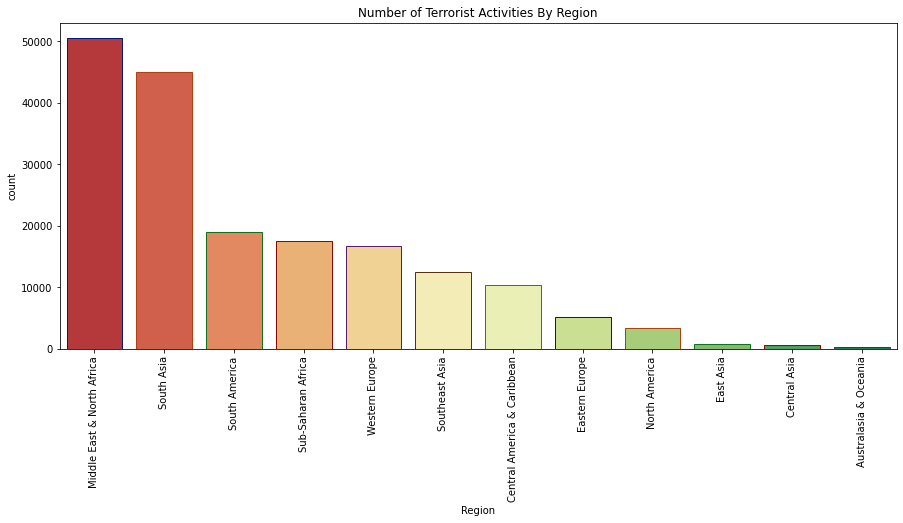

In [18]:
plt.subplots(figsize = (15,6))
sns.countplot('Region',data = df, palette = 'RdYlGn', edgecolor = sns.color_palette('dark',7), order=df['Region'].value_counts().index)
plt.xticks(rotation = 90)
plt.title('Number of Terrorist Activities By Region')
plt.show()


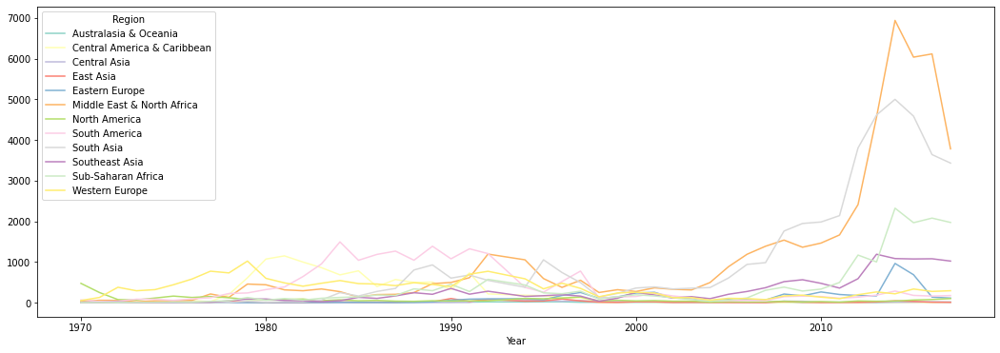

In [19]:
df_region = pd.crosstab(df.Year, df.Region)
df_region.plot(color=sns.color_palette('Set3', 12))
fig = plt.gcf()
fig.set_size_inches(18,6)
plt.show()

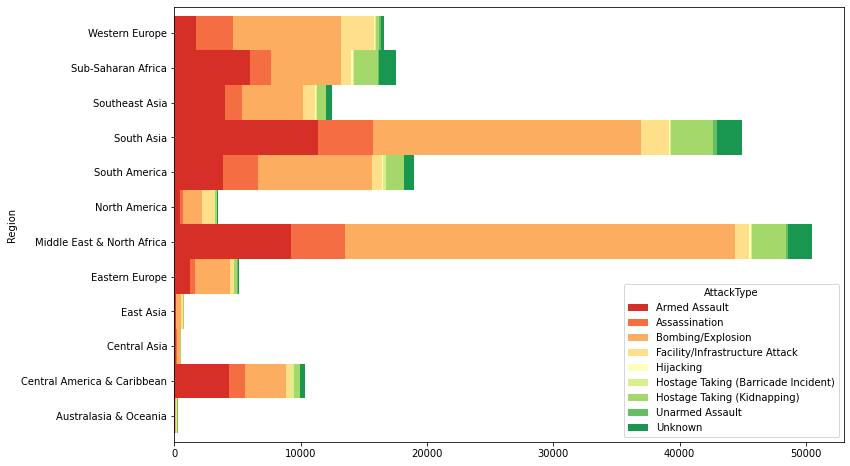

In [20]:
pd.crosstab(df.Region, df.AttackType).plot.barh(stacked=True,width =1, color = sns.color_palette('RdYlGn', 9))
fig = plt.gcf()
fig.set_size_inches(12,8)
plt.show()

# Terrorism by country

c:\users\shrim\appdata\local\programs\python\python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


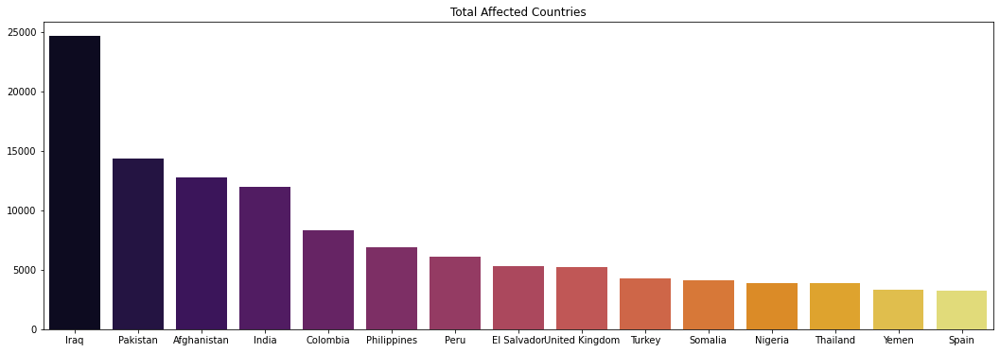

In [21]:
plt.subplots(figsize=(18,6))
sns.barplot(df['Country'].value_counts()[:15].index,df['Country'].value_counts()[:15].values, palette = 'inferno')
plt.title('Total Affected Countries')
plt.show()

Attack vs Killed 

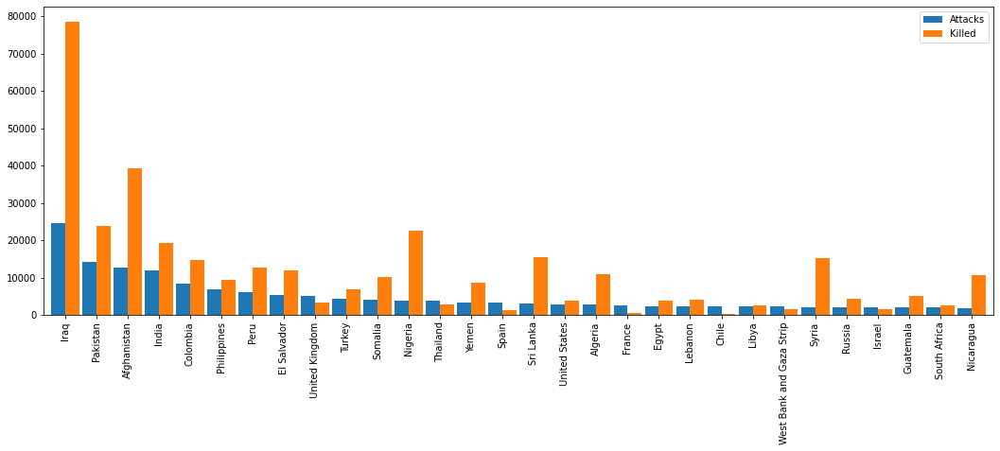

In [22]:
count_df = df['Country'].value_counts()[:30].to_frame()
count_df.columns= ['Attacks']
count_kill = df.groupby('Country')['Killed'].sum().to_frame()
count_df.merge(count_kill,left_index = True,right_index = True, how = 'left').plot.bar(width=0.9)
fig = plt.gcf()
fig.set_size_inches(18,6)
plt.show()

Most famous Terrorist group

c:\users\shrim\appdata\local\programs\python\python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


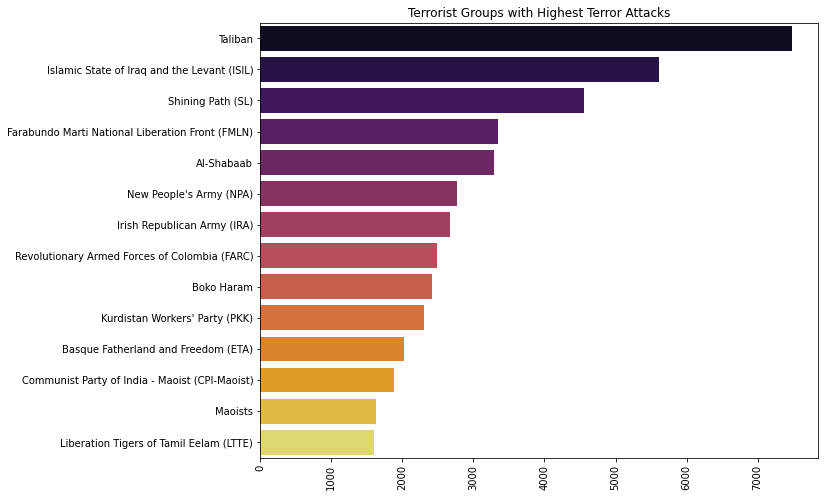

In [23]:
sns.barplot(df['Group'].value_counts()[1:15].values, df['Group'].value_counts()[1:15].index, palette = 'inferno')
plt.xticks(rotation = 90)
fig = plt.gcf()
fig.set_size_inches(10,8)
plt.title('Terrorist Groups with Highest Terror Attacks')
plt.show()

Regions attacked by terrorist Groups

C:\Users\shrim\AppData\Local\Temp/ipykernel_2800/2329114748.py:15: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go" (-> color='g'). The keyword argument will take precedence.
  m4.plot(x_group,y_group,'go',markersize=3,color=j,label=i)
C:\Users\shrim\AppData\Local\Temp/ipykernel_2800/2329114748.py:15: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go" (-> color='g'). The keyword argument will take precedence.
  m4.plot(x_group,y_group,'go',markersize=3,color=j,label=i)
C:\Users\shrim\AppData\Local\Temp/ipykernel_2800/2329114748.py:15: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "go" (-> color='g'). The keyword argument will take precedence.
  m4.plot(x_group,y_group,'go',markersize=3,color=j,label=i)
C:\Users\shrim\AppData\Local\Temp/ipykernel_2800/2329114748.py:15: UserWarning: color is redundantly defined by the 'color' keyword argument and 

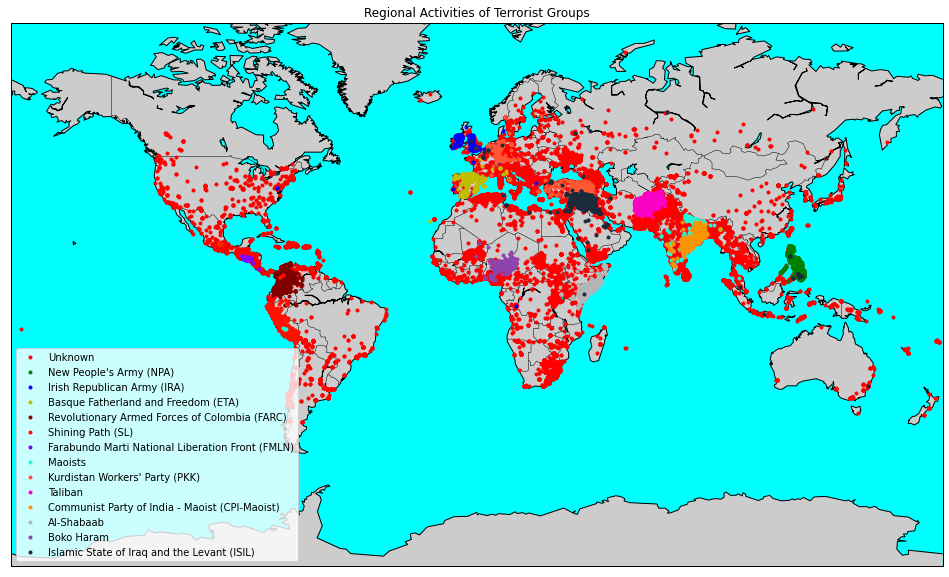

In [24]:
top_groups=df[df['Group'].isin(df['Group'].value_counts()[:14].index)]
m4 = Basemap(projection='mill',llcrnrlat=-80,urcrnrlat=80, llcrnrlon=-180,urcrnrlon=180,lat_ts=20,resolution='c',lat_0=True,lat_1=True)
m4.drawcoastlines()
m4.drawcountries()
m4.fillcontinents(lake_color='aqua')
m4.drawmapboundary(fill_color='aqua')
fig=plt.gcf()
fig.set_size_inches(22,10)
colors=['r','g','b','y','#800000','#ff1100','#8202fa','#20fad9','#ff5733','#fa02c6',"#f99504",'#b3b6b7','#8e44ad','#1a2b3c']
group=list(top_groups['Group'].unique())
def group_point(group,color,label):
    lat_group=list(top_groups[top_groups['Group']==group].latitude)
    long_group=list(top_groups[top_groups['Group']==group].longitude)
    x_group,y_group=m4(long_group,lat_group)
    m4.plot(x_group,y_group,'go',markersize=3,color=j,label=i)
for i,j in zip(group,colors):
    group_point(i,j,i)
legend=plt.legend(loc='lower left',frameon=True,prop={'size':10})
frame=legend.get_frame()
frame.set_facecolor('white')
plt.title('Regional Activities of Terrorist Groups')
plt.show()


Activities in INDIA

In [25]:
df_ind = df[df['Country']=='India']
df_ind_fol = df_ind.copy()
df_ind_fol.dropna(subset = ['latitude','longitude'],inplace=True)
loc_ind = df_ind_fol[['latitude','longitude']][:5000]
city_ind = df_ind_fol['city'][:5000]
killed_ind = df_ind_fol['Killed'][:5000]
wound_ind = df_ind_fol['Wounded'][:5000]
target_ind = df_ind_fol['Target_type'][:5000]

map4 = folium.Map(location=[20.59,78.96],tiles = 'CartoDB dark_matter',zoom_start=4.5)
for point in loc_ind.index:
    folium.CircleMarker(list(loc_ind.loc[point].values),popup='<b>City: </b>'+str(city_ind[point])+'<br><b>Killed: </b>'+str(killed_ind[point])+\
                        '<br><b>Injured: </b>'+str(wound_ind[point])+'<br><b>Target: </b>'+str(target_ind[point]),radius=point_size(killed_ind[point]),color=color_point(killed_ind[point]),fill_color=color_point(killed_ind[point])).add_to(map4)
map4

Most Notorious group in INDIA & their favorite attack type

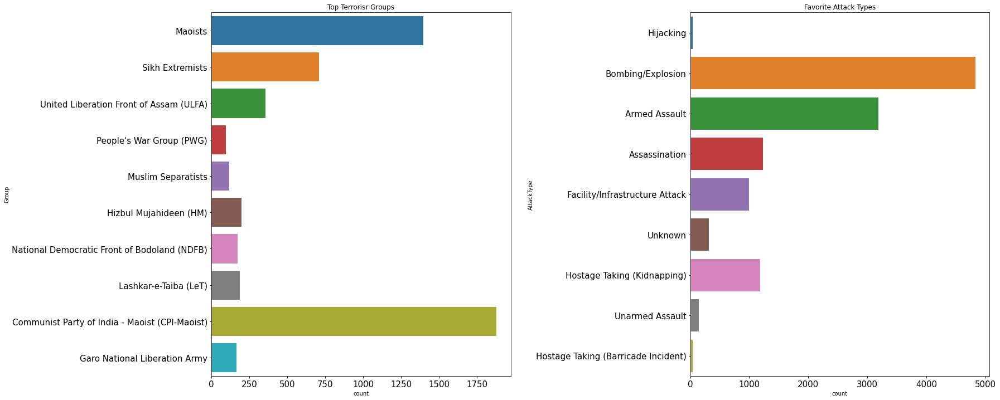

In [26]:
f,ax = plt.subplots(1,2,figsize=(25,12))
ind_grp = df_ind['Group'].value_counts()[1:11].index
ind_grp = df_ind[df_ind['Group'].isin(ind_grp)]
sns.countplot(y= 'Group', data = ind_grp, ax = ax[0])
ax[0].set_title('Top Terrorisr Groups')
sns.countplot(y = 'AttackType', data = df_ind, ax = ax[1])
ax[1].set_title('Favorite Attack Types')
plt.subplots_adjust(hspace = 0.3,wspace = 0.6)
ax[0].tick_params(labelsize = 15)
ax[1].tick_params(labelsize = 15)
plt.show()

Activities in USA

In [27]:
df_us = df[df['Country']=='United States']
df_us_fol = df_us.copy()
df_us_fol.dropna(subset = ['latitude','longitude'],inplace=True)
loc_us = df_us_fol[['latitude','longitude']][:5000]
city_us = df_us_fol['city'][:5000]
killed_us = df_us_fol['Killed'][:5000]
wound_us = df_us_fol['Wounded'][:5000]
target_us = df_us_fol['Target_type'][:5000]

map4 = folium.Map(location=[39.50, -98.35],tiles = 'CartoDB dark_matter',zoom_start=3.5)
for point in loc_us.index:
    folium.CircleMarker(list(loc_us.loc[point].values),popup='<b>City: </b>'+str(city_us[point])+'<br><b>Killed: </b>'+str(killed_us[point])+\
                        '<br><b>Injured: </b>'+str(wound_us[point])+'<br><b>Target: </b>'+str(target_us[point]),radius=point_size(killed_us[point]),color=color_point(killed_us[point]),fill_color=color_point(killed_us[point])).add_to(map4)
map4

Most Notorious Groups in USA and Favorite Attack Type

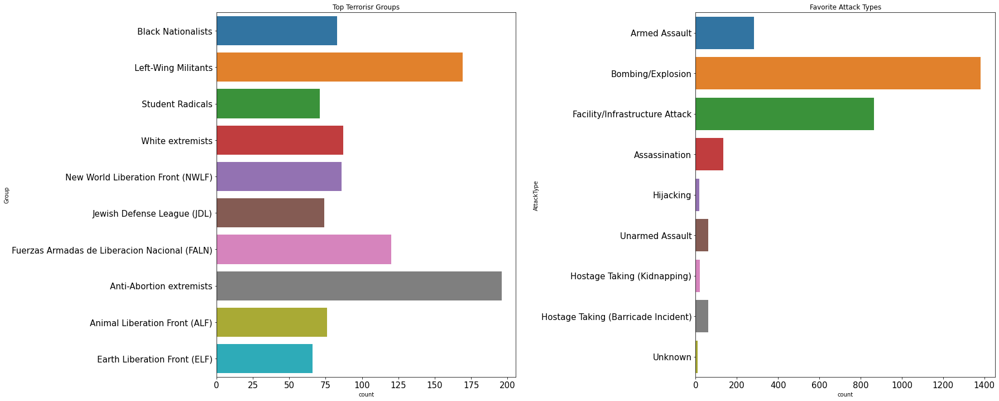

In [28]:
f,ax = plt.subplots(1,2,figsize=(25,12))
us_grp = df_us['Group'].value_counts()[1:11].index
us_grp = df_us[df_us['Group'].isin(us_grp)]
sns.countplot(y= 'Group', data = us_grp, ax = ax[0])
ax[0].set_title('Top Terrorisr Groups')
sns.countplot(y = 'AttackType', data = df_us, ax = ax[1])
ax[1].set_title('Favorite Attack Types')
plt.subplots_adjust(hspace = 0.3,wspace = 0.6)
ax[0].tick_params(labelsize = 15)
ax[1].tick_params(labelsize = 15)
plt.show()